# Lesson 7: Post-Training Procedures for Diffusion Models

[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/jonathandinu/programming-generative-ai/blob/main/notebooks/07-post-training-diffusion.ipynb) [![GitHub Repo stars](https://img.shields.io/github/stars/jonathandinu/programming-generative-ai?style=social)](https://github.com/jonathandinu/programming-generative-ai)

> Colab for interactive execution in your browser (no setup) and repository for notebook index and additional resources (slides, etc.)

## Setup/Installs (takes a minute or two)

In [1]:
# install diffusers and transformers from source (for cloud notebook environments, i.e. Google Colab)
%pip install -U torch==2.5.0 torchvision triton==3.1.0 torchmetrics[multimodal] bitsandbytes git+https://github.com/huggingface/diffusers.git git+https://github.com/huggingface/transformers.git

  Cloning https://github.com/huggingface/diffusers.git to /tmp/pip-req-build-zqsjx982
  Running command git clone --filter=blob:none --quiet https://github.com/huggingface/diffusers.git /tmp/pip-req-build-zqsjx982
  Resolved https://github.com/huggingface/diffusers.git to commit 5a196e3d46e87d50a1c993a13d2589d40739dc63
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Cloning https://github.com/huggingface/transformers.git to /tmp/pip-req-build-v6ajvm_b
  Running command git clone --filter=blob:none --quiet https://github.com/huggingface/transformers.git /tmp/pip-req-build-v6ajvm_b
  Resolved https://github.com/huggingface/transformers.git to commit 5615a393691c81e00251e420c73e4d04c6fe22e5
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
INFO: pip is looking at multiple versions of torchvision to determine which ver

In [2]:
# additional non-torch related dependencies
%pip install -U peft matplotlib scikit-image image-reward av==13 imageio[pyav] mediapy git+https://github.com/openai/CLIP.git

  Cloning https://github.com/openai/CLIP.git to /tmp/pip-req-build-8ufii2ev
  Running command git clone --filter=blob:none --quiet https://github.com/openai/CLIP.git /tmp/pip-req-build-8ufii2ev
  Resolved https://github.com/openai/CLIP.git to commit dcba3cb2e2827b402d2701e7e1c7d9fed8a20ef1
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 266.3/266.3 kB 25.4 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Installing backend dependencies ... done
  Preparing metadata (pyproject.toml) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 33.0/33.0 MB 11.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 374.8/374.8 kB 30.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.6/8.6 MB 122.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.8/14.8 MB 115.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.3/42.3 kB 4.0 MB/s eta 0:00:00
   ━━━━━━━━

In [3]:
!git clone https://github.com/tgxs002/HPSv2.git

Cloning into 'HPSv2'...
remote: Enumerating objects: 429, done.
remote: Counting objects: 100% (40/40), done.
remote: Compressing objects: 100% (13/13), done.
remote: Total 429 (delta 32), reused 27 (delta 27), pack-reused 389 (from 1)
Receiving objects: 100% (429/429), 8.65 MiB | 18.14 MiB/s, done.
Resolving deltas: 100% (245/245), done.


In [4]:
%cd HPSv2/

/content/HPSv2


In [5]:
!pip install .

Processing /content/HPSv2
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 316.8/316.8 kB 27.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 66.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 74.8/74.8 kB 8.7 MB/s eta 0:00:00
  Created wheel for hpsv2: filename=hpsv2-1.2.0-py3-none-any.whl size=9028198 sha256=10a5c4de036b3bcd5a69f3501c46fc54bb4a6408877d8b04d698e1184bbd6682
  Stored in directory: /tmp/pip-ephem-wheel-cache-2z3afzs5/wheels/82/59/06/ab574269aff29eb408802b5a23eb2faf5c06b01ac3a98164df
  Created wheel for clint: filename=clint-0.5.1-py3-none-any.whl size=34459 sha256=e1737ac72fd62639a628ba72522b58e6926f6d52ca7a9979979e4d1a4aba0dfc
  Stored in directory: /root/.cache/pip/wheels/60/bd/a0/c20dd085251d95af656b5e3d287db7d4b4e8aec67b53a6f8dd
  Created wheel for args: filename=args-0.1.0-py3-none-any.whl size=3319 sha256=3b98

In [6]:
%cd ..

/content


In [7]:
import torch, requests, os, random, time
import numpy as np
from PIL import Image
from tqdm import tqdm

from diffusers import DiffusionPipeline, AutoencoderKL, DDIMScheduler, utils

# default device boilerplate
device = (
    "cuda" # Device for NVIDIA or AMD GPUs
    if torch.cuda.is_available()
    else "mps" # Device for Apple Silicon (Metal Performance Shaders)
    if torch.backends.mps.is_available()
    else "cpu"
)
print(f"Using {device} device")

The cache for model files in Transformers v4.22.0 has been updated. Migrating your old cache. This is a one-time only operation. You can interrupt this and resume the migration later on by calling `transformers.utils.move_cache()`.


0it [00:00, ?it/s]

Using cuda device


## 7.1 Methods and Metrics for Evaluating Generative AI

1. Direct Qualitative (user study) -- most effective but most expensive in time and money
2. Quantitative Proxies (FID, CLIP Score) -- easiest to apply on large scale but least true
3. Human Preference Predictor (PickScore, aesthetic-predictor, etc.) -- hybrid of 1) and 2)

* Evaluation Datasets/prompts
  * DrawBench: https://arxiv.org/pdf/2205.11487
  * HEIM: https://crfm.stanford.edu/helm/heim/latest/
  * PartiPrompts: https://github.com/google-research/parti
  * LAION Aesthetics: https://laion.ai/blog/laion-aesthetics/
  * Pick-a-Pic: https://arxiv.org/abs/2305.01569
  * DiffusionDB: https://poloclub.github.io/diffusiondb/
  * AVA: https://huggingface.co/datasets/Iceclear/AVA
  
* Human Preference Predictors:
  * PickScore: https://github.com/yuvalkirstain/PickScore
  * aesthetic-predictor: https://github.com/christophschuhmann/improved-aesthetic-predictor
  * Human Preference Score: https://github.com/tgxs002/HPSv2
  * ImageReward: https://github.com/THUDM/ImageReward
  * https://github.com/tgxs002/align_sd


In [8]:
pipeline1 = DiffusionPipeline.from_pretrained("runwayml/stable-diffusion-v1-5", torch_dtype=torch.float16, variant="fp16")
pipeline1.scheduler = DDIMScheduler.from_config(pipeline1.scheduler.config)

vae = AutoencoderKL.from_pretrained("madebyollin/sdxl-vae-fp16-fix", torch_dtype=torch.float16)
pipeline2 = DiffusionPipeline.from_pretrained("stabilityai/stable-diffusion-xl-base-1.0", vae=vae, torch_dtype=torch.float16, variant="fp16")
pipeline2.scheduler = DDIMScheduler.from_config(pipeline2.scheduler.config)

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


model_index.json:   0%|          | 0.00/541 [00:00<?, ?B/s]

Fetching 15 files:   0%|          | 0/15 [00:00<?, ?it/s]

model.fp16.safetensors:   0%|          | 0.00/608M [00:00<?, ?B/s]

model.fp16.safetensors:   0%|          | 0.00/246M [00:00<?, ?B/s]

text_encoder/config.json:   0%|          | 0.00/617 [00:00<?, ?B/s]

safety_checker/config.json:   0%|          | 0.00/4.72k [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/308 [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

(…)ature_extractor/preprocessor_config.json:   0%|          | 0.00/342 [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/1.72G [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/806 [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/167M [00:00<?, ?B/s]

vae/config.json:   0%|          | 0.00/547 [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/743 [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

config.json:   0%|          | 0.00/631 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

model_index.json:   0%|          | 0.00/609 [00:00<?, ?B/s]

Fetching 17 files:   0%|          | 0/17 [00:00<?, ?it/s]

model.fp16.safetensors:   0%|          | 0.00/1.39G [00:00<?, ?B/s]

model.fp16.safetensors:   0%|          | 0.00/246M [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/737 [00:00<?, ?B/s]

text_encoder/config.json:   0%|          | 0.00/565 [00:00<?, ?B/s]

text_encoder_2/config.json:   0%|          | 0.00/575 [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/479 [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

tokenizer_2/tokenizer_config.json:   0%|          | 0.00/725 [00:00<?, ?B/s]

tokenizer_2/special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/5.14G [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/1.68k [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/167M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

## 7.2 Manual Evaluation of Stable Diffusion with DrawBench

In [9]:
# https://docs.google.com/spreadsheets/d/1y7nAbmR4FREi6npB1u-Bo3GFdwdOPYJc617rBOxIRHY

draw_bench = [
  "A blue bird and a brown bear.", # colors
  "Hovering cow abducting aliens.", #conflicting
  "Three cats and three dogs sitting on the grass.", #counting
  "A small domesticated carnivorous mammal with soft fur, a short snout, and retractable claws. It is widely kept as a pet or for catching mice, and many breeds have been developed.", # description
  "A carrot on the left of a broccoli.", # positional
  "A storefront with 'Hello World' written on it." # text
]

In [10]:
images = []

for pipeline in [pipeline1, pipeline2]:
  pipeline.to(device)

  for prompt in draw_bench:
    images += pipeline(
        prompt=prompt,
        num_inference_steps=30,
        generator=torch.manual_seed(666)
    ).images

  # free up GPU memory
  pipeline.to('cpu')

del pipeline
del pipeline1
del pipeline2

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/30 [00:00<?, ?it/s]

Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, due to the lack of support for`float16` operations on this device in PyTorch. Please, remove the `torch_dtype=torch.float16` argument, or use another device for inference.
Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, due to the lack of support for`float16` operations on this device in PyTorch. Please, remove the `torch_dtype=torch.float16` argument, or use another device for inference.
Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, du

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, due to the lack of support for`float16` operations on this device in PyTorch. Please, remove the `torch_dtype=torch.float16` argument, or use another device for inference.
Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, due to the lack of support for`float16` operations on this device in PyTorch. Please, remove the `torch_dtype=torch.float16` argument, or use another device for inference.
Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, du

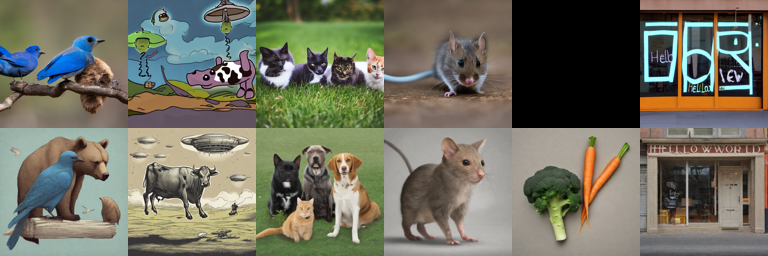

In [11]:
utils.make_image_grid([ img.resize((128, 128)) for img in images ], rows=2, cols=len(draw_bench))

## 7.3 Quantitative Evaluation of Diffusion Models with Human Preference Predictors

In [12]:
import hpsv2, ImageReward

from torchmetrics.multimodal.clip_score import CLIPScore
from torchmetrics.multimodal import CLIPImageQualityAssessment
from torchvision.transforms.functional import pil_to_tensor

image_reward = ImageReward.load("ImageReward-v1.0")

clip_score = CLIPScore(model_name_or_path="openai/clip-vit-base-patch16")
clip_iqa = CLIPImageQualityAssessment(prompts=("quality", "brightness", "real", "natural"), data_range=255)

ImageReward.pt:   0%|          | 0.00/1.79G [00:00<?, ?B/s]

load checkpoint from /root/.cache/ImageReward/ImageReward.pt


med_config.json:   0%|          | 0.00/485 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/570 [00:00<?, ?B/s]

checkpoint loaded


config.json:   0%|          | 0.00/4.10k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/599M [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/316 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/905 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/961k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/599M [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/2.22M [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/389 [00:00<?, ?B/s]

__Built-in CLIP-IQA Prompts__

||||
|:--|:--|:--|
|`quality` | Good photo. | Bad photo. |
|`brightness` | Bright photo. | Dark photo.|
|`noisiness` | Clean photo. | Noisy photo.|
|`colorfullness` | Colorful photo. | Dull photo.|
|`sharpness` | Sharp photo. | Blurry photo.|
|`contrast` | High contrast photo. | Low contrast photo.|
|`complexity` | Complex photo. | Simple photo.|
|`natural` | Natural photo. | Synthetic photo.|
|`happy` | Happy photo. | Sad photo.|
|`scary` | Scary photo. | Peaceful photo.|
|`new` | New photo. | Old photo.|
|`warm` | Warm photo. | Cold photo.|
|`real` | Real photo. | Abstract photo.|
|`beautiful` | Beautiful photo. | Ugly photo.|
|`lonely` | Lonely photo. | Sociable photo.|
|`relaxing` | Relaxing photo. | Stressful photo.|

INFO:root:Loaded ViT-H-14 model config.


open_clip_pytorch_model.bin:   0%|          | 0.00/3.94G [00:00<?, ?B/s]

INFO:root:Loading pretrained ViT-H-14 weights (laion2B-s32B-b79K).


HPS_v2.1_compressed.pt:   0%|          | 0.00/1.97G [00:00<?, ?B/s]

A blue bird and a brown bear.


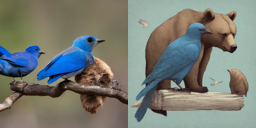

ImageReward	-1.4577091932296753	1.8630014657974243
HPS		0.27880859375		0.30517578125

CLIP Score	0.315716028213501	0.3612133264541626
IQA quality 	0.9977753758430481	0.9774743914604187
IQA brightness	0.98956698179245	0.9807751178741455
IQA real    	0.9686784148216248	0.9991759657859802
IQA natural 	0.9469305872917175	0.9272938370704651


Hovering cow abducting aliens.


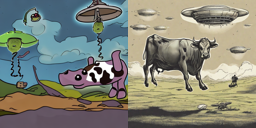

ImageReward	1.4958852529525757	1.946258544921875
HPS		0.2205810546875		0.278564453125

CLIP Score	0.35598224401474	0.33354178071022034
IQA quality 	0.883122444152832	0.9862164258956909
IQA brightness	0.977709174156189	0.9691560864448547
IQA real    	0.9982448816299438	0.9996107220649719
IQA natural 	0.7865792512893677	0.8336026072502136


Three cats and three dogs sitting on the grass.


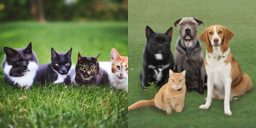

ImageReward	0.4188724458217621	1.775948405265808
HPS		0.2783203125		0.291259765625

CLIP Score	0.31884410977363586	0.3287543058395386
IQA quality 	0.9240537285804749	0.8528851270675659
IQA brightness	0.9073901772499084	0.9392908215522766
IQA real    	0.974825918674469	0.9992572665214539
IQA natural 	0.7687720060348511	0.8920567035675049


A small domesticated carnivorous mammal with soft fur, a short snout, and retractable claws. It is widely kept as a pet or for catching mice, and many breeds have been developed.


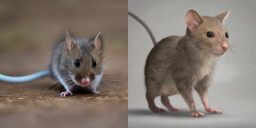

ImageReward	0.892433226108551	0.9902933835983276
HPS		0.234619140625		0.2310791015625

CLIP Score	0.3062765598297119	0.322553813457489
IQA quality 	0.9335950016975403	0.732418417930603
IQA brightness	0.6915099620819092	0.8582934141159058
IQA real    	0.7965490221977234	0.9878553748130798
IQA natural 	0.9007583260536194	0.8025875091552734


A carrot on the left of a broccoli.


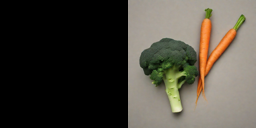

ImageReward	-2.251758575439453	1.340220332145691
HPS		0.1337890625		0.28125

CLIP Score	0.1955568641424179	0.33467403054237366
IQA quality 	0.46541357040405273	0.8534958362579346
IQA brightness	0.03241574391722679	0.8942079544067383
IQA real    	0.9725660681724548	0.9954729676246643
IQA natural 	0.34205278754234314	0.9327789545059204


A storefront with 'Hello World' written on it.


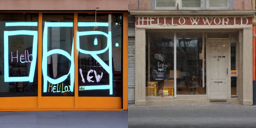

ImageReward	0.2802879214286804	1.8878004550933838
HPS		0.2059326171875		0.26220703125

CLIP Score	0.3671641945838928	0.41270768642425537
IQA quality 	0.7853344678878784	0.2799215316772461
IQA brightness	0.9931604862213135	0.7162428498268127
IQA real    	0.9753115773200989	0.9982950091362
IQA natural 	0.26755353808403015	0.4930836856365204




In [13]:
img_pairs = zip(images[:len(draw_bench)], images[len(draw_bench):], draw_bench)

for img1, img2, prompt in img_pairs:
  t1 = pil_to_tensor(img1)
  t2 = pil_to_tensor(img2.resize((512, 512)))

  # score dist. normalized to have mean 0 and std 1
  irs = image_reward.score(prompt, [img1, img2])

  # 0 -> 1 softmax score (higher is better)
  hps = hpsv2.score([img1, img2], prompt, hps_version="v2.1")

  # 0 -> 1 (higher is better)
  s1 = clip_score(t1, prompt) / 100
  s2 = clip_score(t2, prompt) / 100

  # 0 -> 1 (higher is better)
  iqa = clip_iqa(torch.stack([t1, t2]))

  print(prompt)
  display(utils.make_image_grid([img1.resize((128, 128)), img2.resize((128, 128))], rows=1, cols=2))

  print(f"ImageReward\t{irs[0]}\t{irs[1]}\nHPS\t\t{hps[0]}\t\t{hps[1]}\n\nCLIP Score\t{s1}\t{s2}")

  for key in iqa:
    print(f"IQA {key:8}\t{iqa[key][0]}\t{iqa[key][1]}")
  print("\n")

## 7.4 Overview of Methods for Fine-Tuning Diffusion Models

5-ish types of fine-tuning:

1. Plain old full fine-tuning
2. [LoRA](https://github.com/cloneofsimo/lora) w/ diffusion models  (original LLM [paper](https://arxiv.org/abs/2106.09685))
3. [DreamBooth](https://arxiv.org/abs/2208.12242)
4. [Textual Inversion](https://arxiv.org/abs/2208.01618) (v. small and adapterless -- just need the same model)
5. [RL based](https://huggingface.co/docs/trl/en/index) methods like DDPO

In [14]:
# fix for an encoding issue that can come up when running shell commands
# https://github.com/googlecolab/colabtools/issues/3409
import locale
locale.getpreferredencoding = lambda *args: "UTF-8"

In [15]:
!wget -nc https://raw.githubusercontent.com/huggingface/diffusers/main/examples/text_to_image/train_text_to_image_lora_sdxl.py

--2024-12-16 01:54:31--  https://raw.githubusercontent.com/huggingface/diffusers/main/examples/text_to_image/train_text_to_image_lora_sdxl.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.111.133, 185.199.110.133, 185.199.109.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.111.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 55573 (54K) [text/plain]
Saving to: ‘train_text_to_image_lora_sdxl.py’

train_text_to_image 100%[===================>]  54.27K  --.-KB/s    in 0.001s  

2024-12-16 01:54:32 (48.3 MB/s) - ‘train_text_to_image_lora_sdxl.py’ saved [55573/55573]



## 7.5 Sourcing and Preparing Image Datasets for Fine-Tuning

In [16]:
from datasets import load_dataset

dataset = load_dataset("jonathandinu/merian-metamorphosis", split="train")

README.md:   0%|          | 0.00/1.50k [00:00<?, ?B/s]

Resolving data files:   0%|          | 0/60 [00:00<?, ?it/s]

0024.png:   0%|          | 0.00/1.30M [00:00<?, ?B/s]

0036.png:   0%|          | 0.00/1.25M [00:00<?, ?B/s]

0054.png:   0%|          | 0.00/1.26M [00:00<?, ?B/s]

0048.png:   0%|          | 0.00/1.23M [00:00<?, ?B/s]

0021.png:   0%|          | 0.00/1.25M [00:00<?, ?B/s]

0015.png:   0%|          | 0.00/1.34M [00:00<?, ?B/s]

0051.png:   0%|          | 0.00/1.30M [00:00<?, ?B/s]

0039.png:   0%|          | 0.00/1.17M [00:00<?, ?B/s]

0042.png:   0%|          | 0.00/1.32M [00:00<?, ?B/s]

0045.png:   0%|          | 0.00/1.26M [00:00<?, ?B/s]

0027.png:   0%|          | 0.00/1.26M [00:00<?, ?B/s]

0030.png:   0%|          | 0.00/1.27M [00:00<?, ?B/s]

0033.png:   0%|          | 0.00/1.23M [00:00<?, ?B/s]

0012.png:   0%|          | 0.00/1.56M [00:00<?, ?B/s]

0018.png:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

0057.png:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

0081.png:   0%|          | 0.00/1.14M [00:00<?, ?B/s]

0063.png:   0%|          | 0.00/1.37M [00:00<?, ?B/s]

0060.png:   0%|          | 0.00/1.28M [00:00<?, ?B/s]

0087.png:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

0066.png:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

0072.png:   0%|          | 0.00/1.23M [00:00<?, ?B/s]

0084.png:   0%|          | 0.00/1.27M [00:00<?, ?B/s]

0105.png:   0%|          | 0.00/1.15M [00:00<?, ?B/s]

0102.png:   0%|          | 0.00/1.25M [00:00<?, ?B/s]

0099.png:   0%|          | 0.00/1.24M [00:00<?, ?B/s]

0090.png:   0%|          | 0.00/1.26M [00:00<?, ?B/s]

0093.png:   0%|          | 0.00/1.14M [00:00<?, ?B/s]

0069.png:   0%|          | 0.00/1.17M [00:00<?, ?B/s]

0096.png:   0%|          | 0.00/1.25M [00:00<?, ?B/s]

0078.png:   0%|          | 0.00/1.15M [00:00<?, ?B/s]

0075.png:   0%|          | 0.00/1.24M [00:00<?, ?B/s]

0108.png:   0%|          | 0.00/1.17M [00:00<?, ?B/s]

0114.png:   0%|          | 0.00/1.24M [00:00<?, ?B/s]

0111.png:   0%|          | 0.00/1.23M [00:00<?, ?B/s]

0120.png:   0%|          | 0.00/1.17M [00:00<?, ?B/s]

0144.png:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

0129.png:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

0132.png:   0%|          | 0.00/1.27M [00:00<?, ?B/s]

0126.png:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

0138.png:   0%|          | 0.00/1.14M [00:00<?, ?B/s]

0117.png:   0%|          | 0.00/1.16M [00:00<?, ?B/s]

0135.png:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

0141.png:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

0123.png:   0%|          | 0.00/1.17M [00:00<?, ?B/s]

0147.png:   0%|          | 0.00/1.23M [00:00<?, ?B/s]

0153.png:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

0156.png:   0%|          | 0.00/1.27M [00:00<?, ?B/s]

0159.png:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

0165.png:   0%|          | 0.00/1.26M [00:00<?, ?B/s]

0174.png:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

0162.png:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

0171.png:   0%|          | 0.00/1.24M [00:00<?, ?B/s]

0183.png:   0%|          | 0.00/1.11M [00:00<?, ?B/s]

0168.png:   0%|          | 0.00/1.16M [00:00<?, ?B/s]

0186.png:   0%|          | 0.00/1.25M [00:00<?, ?B/s]

0177.png:   0%|          | 0.00/1.34M [00:00<?, ?B/s]

0180.png:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

0189.png:   0%|          | 0.00/1.25M [00:00<?, ?B/s]

0150.png:   0%|          | 0.00/1.24M [00:00<?, ?B/s]

Generating train split:   0%|          | 0/60 [00:00<?, ? examples/s]

In [17]:
dataset[0]

{'image': <PIL.PngImagePlugin.PngImageFile image mode=RGB size=1024x1024>}

## 7.6 Generating Automatic Captions with BLIP-2

In [18]:
from transformers import pipeline

captioner = pipeline("image-to-text", model="Salesforce/blip2-opt-2.7b", device=device)

config.json:   0%|          | 0.00/1.03k [00:00<?, ?B/s]

model.safetensors.index.json:   0%|          | 0.00/122k [00:00<?, ?B/s]

model-00001-of-00002.safetensors:   0%|          | 0.00/10.0G [00:00<?, ?B/s]

model-00002-of-00002.safetensors:   0%|          | 0.00/4.98G [00:00<?, ?B/s]

Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

generation_config.json:   0%|          | 0.00/141 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/882 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/798k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/3.56M [00:00<?, ?B/s]

added_tokens.json:   0%|          | 0.00/23.0 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/548 [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/432 [00:00<?, ?B/s]

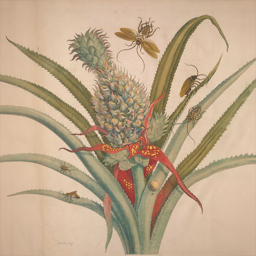

In [19]:
dataset['image'][0].resize((256, 256))

In [20]:
captioner(dataset['image'][0])

[{'generated_text': 'a pineapple with insects on it\n'}]

In [21]:
!mkdir metamorphosis

In [22]:
captions = {}

for idx, img in tqdm(enumerate(dataset['image'])):
  fname = f"{idx:04}.png"
  captions[fname] = captioner(img)[0]['generated_text'].strip()
  img.save(f"metamorphosis/{fname}")

60it [00:58,  1.03it/s]


In [23]:
import pandas as pd

# write captions to metadata file
df = pd.DataFrame.from_dict(captions, orient="index").reset_index()
df.columns = ['file_name', 'text']
df.to_csv('metamorphosis/metadata.csv')

In [24]:
df

,file_name,text
0,0000.png,a pineapple with insects on it
1,0001.png,a drawing of a pineapple with butterflies and ...
2,0002.png,a drawing of a butterfly and moth on a plant
3,0003.png,a drawing of a lizard and some plants
4,0004.png,a drawing of a plant with a snake and a butterfly
5,0005.png,a drawing of a plant with butterflies and berries
6,0006.png,a drawing of two butterflies and a butterfly o...
7,0007.png,a drawing of a plant with butterflies and flowers
8,0008.png,an old book with butterflies and flowers on it
9,0009.png,a drawing of a plant with butterflies and insects


In [25]:
import gc

# free up GPU memory
captioner.model.to('cpu')
gc.collect()
torch.cuda.empty_cache()
del captioner

## 7.7 Parameter Efficient Fine-Tuning with LoRA

In [26]:
!accelerate config default

accelerate configuration saved at /root/.cache/huggingface/accelerate/default_config.yaml


In [27]:
%load_ext tensorboard

In [28]:
# Tensorboard only shows output if running the finetuning yourself
%tensorboard --logdir sdxl-metamorphosis

<IPython.core.display.Javascript object>

In [29]:
# if running into memory issues add: --gradient_checkpointing --use_8bit_adam

# uncomment to run fine tuning yourself in notebook
#
# !accelerate launch train_text_to_image_lora_sdxl.py \
#   --pretrained_model_name_or_path="stabilityai/stable-diffusion-xl-base-1.0" \
#   --pretrained_vae_model_name_or_path="madebyollin/sdxl-vae-fp16-fix" \
#   --train_data_dir="metamorphosis" --caption_column="text" \
#   --resolution=1024 --random_flip \
#   --train_batch_size=1 \
#   --num_train_epochs=10 --checkpointing_steps=100 \
#   --learning_rate=1e-04 --lr_scheduler="constant" --lr_warmup_steps=0 \
#   --mixed_precision="fp16" \
#   --seed=404 \
#   --output_dir="sdxl-metamorphosis" \
#   --validation_epochs=2 \
#   --validation_prompt="A blue bird and a brown bear." \
#   --resume_from_checkpoint="latest"

In [30]:
from huggingface_hub import notebook_login

# if you want to push your fine-tuning model to HF hub
# notebook_login()

# add option to script ☝️
# --push_to_hub

## 7.8 Inspecting the Results of Fine-Tuning

In [31]:
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [32]:
# Tensorboard only shows output if you ran the finetuning yourself
%tensorboard --logdir sdxl-metamorphosis

Reusing TensorBoard on port 6006 (pid 4523), started 0:00:01 ago. (Use '!kill 4523' to kill it.)

<IPython.core.display.Javascript object>

In [33]:
# f"LoRA weights are only {os.stat('sdxl-metamorphosis/pytorch_lora_weights.safetensors').st_size / (1024 * 1024):.2f}MB"

## 7.9 Inference with LoRAs for Style-Specific Generation

* https://huggingface.co/spaces/multimodalart/LoraTheExplorer
* https://huggingface.co/spaces/enzostvs/lora-studio
* https://huggingface.co/models?other=lora

In [34]:
vae = AutoencoderKL.from_pretrained("madebyollin/sdxl-vae-fp16-fix", torch_dtype=torch.float16)

pipeline = DiffusionPipeline.from_pretrained("stabilityai/stable-diffusion-xl-base-1.0",  vae=vae, torch_dtype=torch.float16, variant="fp16")
pipeline.to("cuda")

prompt = "An astronaut riding a seahorse"

orig_img = pipeline(
  prompt=prompt,
  num_inference_steps=30,
  generator=torch.manual_seed(17)
).images[0]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

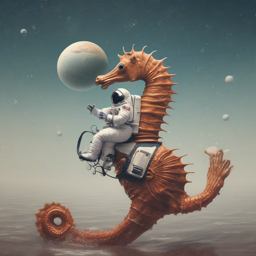

In [35]:
orig_img.resize((256, 256))

In [36]:
pipeline.load_lora_weights("jonathandinu/sdxl-metamorphosis-lora", weight_name="pytorch_lora_weights.safetensors")

pytorch_lora_weights.safetensors:   0%|          | 0.00/23.4M [00:00<?, ?B/s]

In [37]:
# only works if the weights are available as a local file (i.e. you did the finetuning yourself in the notebook)
# pipeline.load_lora_weights("sdxl-metamorphosis", weight_name="pytorch_lora_weights.safetensors")

In [38]:
lora_img = pipeline(
  prompt=prompt,
  num_inference_steps=30,
  generator=torch.manual_seed(17)
).images[0]

  0%|          | 0/30 [00:00<?, ?it/s]

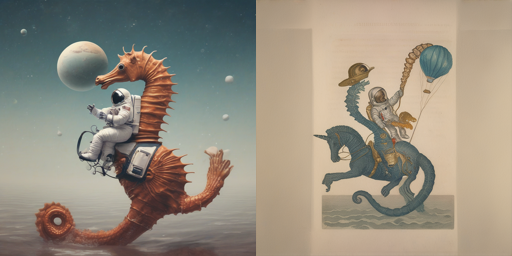

In [39]:
utils.make_image_grid([img.resize((256, 256)) for img in [orig_img, lora_img]], rows=1, cols=2)

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

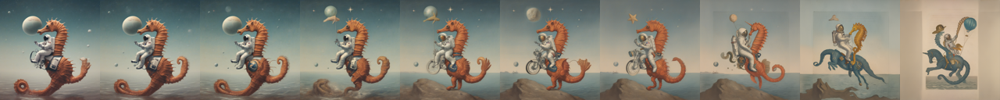

In [40]:
images = []

for s in np.linspace(0, 1, 10):
  images += pipeline(
    prompt=prompt,
    num_inference_steps=30,
    generator=torch.manual_seed(17),
    cross_attention_kwargs={"scale": s}
  ).images

utils.make_image_grid([img.resize((128, 128)) for img in images], rows=1, cols=10)

In [41]:
pipeline.unload_lora_weights()

  0%|          | 0/30 [00:00<?, ?it/s]

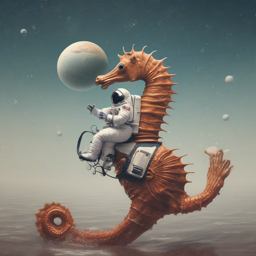

In [42]:
pipeline(
  prompt=prompt,
  num_inference_steps=30,
  generator=torch.manual_seed(17)
).images[0].resize((256, 256))

In [43]:
# cleanup memory
pipeline.to('cpu')
del pipeline

Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, due to the lack of support for`float16` operations on this device in PyTorch. Please, remove the `torch_dtype=torch.float16` argument, or use another device for inference.
Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, due to the lack of support for`float16` operations on this device in PyTorch. Please, remove the `torch_dtype=torch.float16` argument, or use another device for inference.
Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, du

## 7.12 DreamBooth vs LoRA Fine-Tuning

1. Full fine-tuning
2. Special rare-token
3. Class specific prior-preservation loss

> using LoRA w/ dreambooth main unique aspect is prior-preservation (and special "concept" token)... and the script for SDXL actually works well without prior-preservation.

## 7.13 DreamBooth Fine-Tuning with Hugging Face

In [44]:
!wget -nc https://raw.githubusercontent.com/huggingface/diffusers/main/examples/dreambooth/train_dreambooth_lora_sdxl.py

--2024-12-16 02:01:06--  https://raw.githubusercontent.com/huggingface/diffusers/main/examples/dreambooth/train_dreambooth_lora_sdxl.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 84922 (83K) [text/plain]
Saving to: ‘train_dreambooth_lora_sdxl.py’

train_dreambooth_lo 100%[===================>]  82.93K  --.-KB/s    in 0.002s  

2024-12-16 02:01:06 (41.8 MB/s) - ‘train_dreambooth_lora_sdxl.py’ saved [84922/84922]



In [45]:
# teaching diffusion new concepts with Dreambooth
# for low memory: (add --gradient_checkpointing --use_8bit_adam) (remove --train_text_encoder)
# this takes some time either way...

# !accelerate launch train_dreambooth_lora_sdxl.py \
#   --pretrained_model_name_or_path="stabilityai/stable-diffusion-xl-base-1.0" \
#   --instance_data_dir="jonathan-photos" \
#   --pretrained_vae_model_name_or_path="madebyollin/sdxl-vae-fp16-fix" \
#   --output_dir="dreambooth-jonathan" \
#   --mixed_precision="fp16" \
#   --instance_prompt="photo of TOK face" \
#   --with_prior_preservation --prior_loss_weight=1.0 \
#   --class_prompt="a photo of face" \
#   --class_data_dir="prior_photos" \
#   --num_class_images=100 \
#   --sample_batch_size=1 \
#   --random_flip \
#   --resolution=1024 \
#   --train_batch_size=1 \
#   --gradient_accumulation_steps=4 \
#   --train_text_encoder \
#   --gradient_checkpointing \
#   --learning_rate=1e-4 \
#   --lr_scheduler="constant" \
#   --lr_warmup_steps=0 \
#   --max_train_steps=2000 \
#   --validation_prompt="a photo of TOK as an astronaut" \
#   --validation_epochs=5 \
#   --seed="17" \
#   --resume_from_checkpoint="latest"

## 7.14 Inference with DreamBooth to Create Personalized AI Avatars

In [46]:
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [47]:
# Tensorboard only shows output if you ran the finetuning yourself
%tensorboard --logdir dreambooth-jonathan

<IPython.core.display.Javascript object>

In [48]:
# images are only generated if the Dreambooth finetuning script has been run
# utils.make_image_grid([Image.open(f"prior_photos/{path}").resize((128, 128)) for path in random.sample(os.listdir('prior_photos'), 5)], rows=1, cols=5)

In [49]:
# get the Dreambooth lora fro mthe Github repo (instead of the HF Hub)
!wget -nc -P dreambooth-jonathan https://raw.githubusercontent.com/jonathandinu/programming-generative-ai/refs/heads/main/loras/dreambooth-jonathan/pytorch_lora_weights.safetensors

--2024-12-16 02:01:11--  https://raw.githubusercontent.com/jonathandinu/programming-generative-ai/refs/heads/main/loras/dreambooth-jonathan/pytorch_lora_weights.safetensors
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 29868864 (28M) [application/octet-stream]
Saving to: ‘dreambooth-jonathan/pytorch_lora_weights.safetensors’

pytorch_lora_weight 100%[===================>]  28.48M  --.-KB/s    in 0.1s    

2024-12-16 02:01:15 (290 MB/s) - ‘dreambooth-jonathan/pytorch_lora_weights.safetensors’ saved [29868864/29868864]



In [50]:
vae = AutoencoderKL.from_pretrained("madebyollin/sdxl-vae-fp16-fix", torch_dtype=torch.float16)

pipeline = DiffusionPipeline.from_pretrained("stabilityai/stable-diffusion-xl-base-1.0",  vae=vae, torch_dtype=torch.float16, variant="fp16")
pipeline.load_lora_weights("dreambooth-jonathan", weight_name="pytorch_lora_weights.safetensors")
pipeline.to("cuda")

img1 = pipeline(
  prompt="a photo of an astronaut",
  num_inference_steps=30,
  generator=torch.manual_seed(17)
).images[0]

img2 = pipeline(
  prompt="a photo of TOK as an astronaut",
  num_inference_steps=30,
  generator=torch.manual_seed(17)
).images[0]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

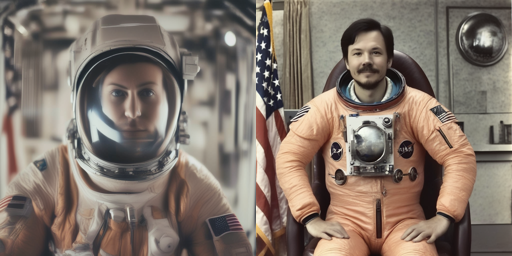

In [51]:
utils.make_image_grid([img1.resize((256, 256)), img2.resize((256, 256))], rows=1, cols=2)

  0%|          | 0/30 [00:00<?, ?it/s]

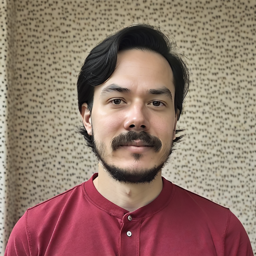

In [52]:
pipeline(
  prompt="a portrait of TOK for instagram",
  num_inference_steps=30,
  generator=torch.manual_seed(17)
).images[0].resize((256, 256))

In [53]:
# free up GPU memory for next sublesson
pipeline.to('cpu')
del pipeline

Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, due to the lack of support for`float16` operations on this device in PyTorch. Please, remove the `torch_dtype=torch.float16` argument, or use another device for inference.
Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, due to the lack of support for`float16` operations on this device in PyTorch. Please, remove the `torch_dtype=torch.float16` argument, or use another device for inference.
Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, du

## 7.16 Creating Edge and Depth Maps for Conditioning

In [54]:
from diffusers import utils
from diffusers import ControlNetModel, StableDiffusionXLControlNetPipeline
from diffusers import AutoencoderKL, MarigoldDepthPipeline, DPMSolverMultistepScheduler

from skimage.util import random_noise
from skimage import feature

depth_estimator = MarigoldDepthPipeline.from_pretrained(
    "prs-eth/marigold-depth-lcm-v1-0", torch_dtype=torch.float16, variant="fp16"
)

model_index.json:   0%|          | 0.00/586 [00:00<?, ?B/s]

Fetching 12 files:   0%|          | 0/12 [00:00<?, ?it/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/824 [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

text_encoder/config.json:   0%|          | 0.00/633 [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/1.85k [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/568 [00:00<?, ?B/s]

model.fp16.safetensors:   0%|          | 0.00/681M [00:00<?, ?B/s]

vae/config.json:   0%|          | 0.00/611 [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/1.73G [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/167M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

### Stock images from Unsplash

* Girl in blue denim jacket riding brown horse during daytime: by <a href="https://unsplash.com/@christinebenton?utm_content=creditCopyText&utm_medium=referral&utm_source=unsplash">Christine Benton</a> on <a href="https://unsplash.com/photos/girl-in-blue-denim-jacket-riding-brown-horse-during-daytime-QY_bTy8tXAA?utm_content=creditCopyText&utm_medium=referral&utm_source=unsplash">Unsplash</a>
* A large bird flying through a cloudy blue sky: by <a href="https://unsplash.com/@pic_nolte?utm_content=creditCopyText&utm_medium=referral&utm_source=unsplash">Christoph Nolte</a> on <a href="https://unsplash.com/photos/a-large-bird-flying-through-a-cloudy-blue-sky-ApW2xFFwLcU?utm_content=creditCopyText&utm_medium=referral&utm_source=unsplash">Unsplash</a>
* A couple of giraffe standing on top of a dry grass field: by <a href="https://unsplash.com/@kianjm?utm_content=creditCopyText&utm_medium=referral&utm_source=unsplash">Kian Malakooti</a> on <a href="https://unsplash.com/photos/a-couple-of-giraffe-standing-on-top-of-a-dry-grass-field-UQPar9EU5Ho?utm_content=creditCopyText&utm_medium=referral&utm_source=unsplash">Unsplash</a>
* A snow covered mountain with a blue sky in the background: by <a href="https://unsplash.com/@lukethornton?utm_content=creditCopyText&utm_medium=referral&utm_source=unsplash">Luke Thornton</a> on <a href="https://unsplash.com/photos/a-snow-covered-mountain-with-a-blue-sky-in-the-background-rx5EinLMQiI?utm_content=creditCopyText&utm_medium=referral&utm_source=unsplash">Unsplash</a>
* A snow covered mountain in the middle of the day: by <a href="https://unsplash.com/@marekpiwnicki?utm_content=creditCopyText&utm_medium=referral&utm_source=unsplash">Marek Piwnicki</a> on <a href="https://unsplash.com/photos/a-snow-covered-mountain-in-the-middle-of-the-day-TdIsYhMuwPc?utm_content=creditCopyText&utm_medium=referral&utm_source=unsplash">Unsplash</a>
* A mountain range with a house in the foreground: by <a href="https://unsplash.com/@cestmoisheedy?utm_content=creditCopyText&utm_medium=referral&utm_source=unsplash">Sarah Sheedy</a> on <a href="https://unsplash.com/photos/a-mountain-range-with-a-house-in-the-foreground-PpGMMvqBo9w?utm_content=creditCopyText&utm_medium=referral&utm_source=unsplash">Unsplash</a>
* A view of a mountain with trees in the foreground: by <a href="https://unsplash.com/@sharadmbhat?utm_content=creditCopyText&utm_medium=referral&utm_source=unsplash">Sharad Bhat</a> on <a href="https://unsplash.com/photos/a-view-of-a-mountain-with-trees-in-the-foreground-AmvLnWUBWWA?utm_content=creditCopyText&utm_medium=referral&utm_source=unsplash">Unsplash</a>
    

In [55]:
# not ideal but this avoids us having to clone the entire repo
!wget -nc -P stock -i https://raw.githubusercontent.com/jonathandinu/programming-generative-ai/refs/heads/main/images/unsplash_permalinks.txt
!rm stock/unsplash_permalinks.txt

--2024-12-16 02:02:48--  https://raw.githubusercontent.com/jonathandinu/programming-generative-ai/refs/heads/main/images/unsplash_permalinks.txt
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 948 [text/plain]
Saving to: ‘stock/unsplash_permalinks.txt’

unsplash_permalinks 100%[===================>]     948  --.-KB/s    in 0s      

2024-12-16 02:02:48 (65.3 MB/s) - ‘stock/unsplash_permalinks.txt’ saved [948/948]

--2024-12-16 02:02:48--  https://raw.githubusercontent.com/jonathandinu/programming-generative-ai/refs/heads/main/images/christine-benton-QY_bTy8tXAA-unsplash.jpg
Reusing existing connection to raw.githubusercontent.com:443.
HTTP request sent, awaiting response... 200 OK
Length: 1152921 (1.1M) [image/jpeg]
Saving to: ‘stock/christine-benton-QY_bTy8

In [56]:
import numpy as np

images = []
canny = []
depths = []

generator=torch.manual_seed(17)
depth_estimator.to(device)

for path in sorted(os.listdir("stock")):
  img = Image.open(f"stock/{path}").resize((1024, 1024))

  # Canny edge detection
  greyscale = np.array(img.convert('L'))
  canny_edge = Image.fromarray(feature.canny(greyscale, sigma=3))

  # depth map prediction
  depth_img = depth_estimator(img, generator=generator).prediction
  depth_map = depth_estimator.image_processor.visualize_depth(depth_img, color_map="binary")[0]

  images.append(img)
  canny.append(canny_edge)
  depths.append(depth_map)

depth_estimator.to('cpu')
del depth_estimator

Marigold predictions...:   0%|          | 0/1 [00:00<?, ?it/s]

Diffusion steps...:   0%|          | 0/1 [00:00<?, ?it/s]

Marigold predictions...:   0%|          | 0/1 [00:00<?, ?it/s]

Diffusion steps...:   0%|          | 0/1 [00:00<?, ?it/s]

Marigold predictions...:   0%|          | 0/1 [00:00<?, ?it/s]

Diffusion steps...:   0%|          | 0/1 [00:00<?, ?it/s]

Marigold predictions...:   0%|          | 0/1 [00:00<?, ?it/s]

Diffusion steps...:   0%|          | 0/1 [00:00<?, ?it/s]

Marigold predictions...:   0%|          | 0/1 [00:00<?, ?it/s]

Diffusion steps...:   0%|          | 0/1 [00:00<?, ?it/s]

Marigold predictions...:   0%|          | 0/1 [00:00<?, ?it/s]

Diffusion steps...:   0%|          | 0/1 [00:00<?, ?it/s]

Marigold predictions...:   0%|          | 0/1 [00:00<?, ?it/s]

Diffusion steps...:   0%|          | 0/1 [00:00<?, ?it/s]

Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, due to the lack of support for`float16` operations on this device in PyTorch. Please, remove the `torch_dtype=torch.float16` argument, or use another device for inference.
Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, due to the lack of support for`float16` operations on this device in PyTorch. Please, remove the `torch_dtype=torch.float16` argument, or use another device for inference.
Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, du

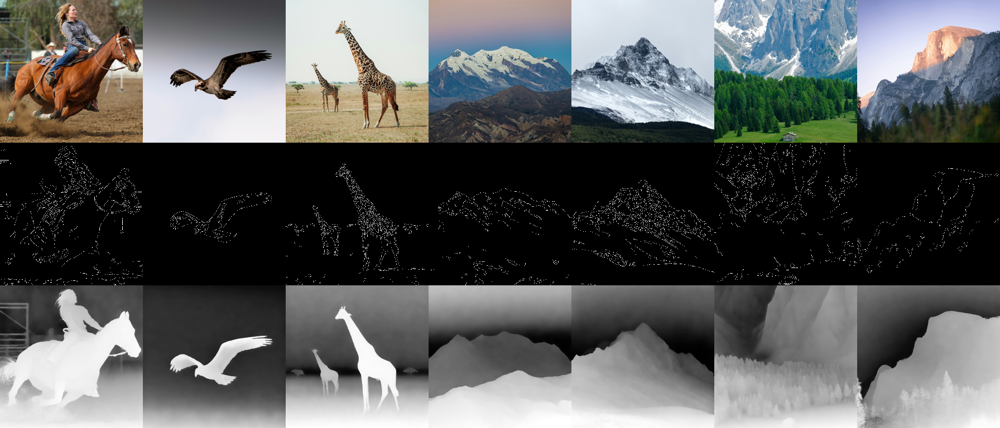

In [57]:
utils.make_image_grid([ img.resize((256, 256)) for img in images + canny + depths ], rows=3, cols=7)

In [58]:
controlnet_canny = ControlNetModel.from_pretrained(
    "diffusers/controlnet-canny-sdxl-1.0",
    variant="fp16",
    use_safetensors=True,
    torch_dtype=torch.float16,
)

controlnet_depth = ControlNetModel.from_pretrained(
    "diffusers/controlnet-depth-sdxl-1.0",
    variant="fp16",
    use_safetensors=True,
    torch_dtype=torch.float16,
)

config.json:   0%|          | 0.00/1.31k [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/2.50G [00:00<?, ?B/s]

config.json:   0%|          | 0.00/1.27k [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/2.50G [00:00<?, ?B/s]

In [59]:
vae = AutoencoderKL.from_pretrained("madebyollin/sdxl-vae-fp16-fix", torch_dtype=torch.float16)

controlnet_pipeline = StableDiffusionXLControlNetPipeline.from_pretrained(
  "stabilityai/stable-diffusion-xl-base-1.0",
  controlnet=controlnet_depth,
  vae=vae,
  variant="fp16",
  use_safetensors=True,
  torch_dtype=torch.float16,
)

controlnet_pipeline.to(device)
controlnet_pipeline.scheduler = DPMSolverMultistepScheduler.from_config(controlnet_pipeline.scheduler.config, use_karras_sigmas=True)

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

## 7.17 Depth and Edge-Guided Stable Diffusion with ControlNet

  0%|          | 0/30 [00:00<?, ?it/s]

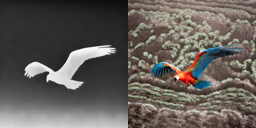

In [60]:
prompt = "a photo of a parrot"
control_img = depths[1]

image = controlnet_pipeline(
  prompt,
  image=control_img,
  num_inference_steps=30,
  generator=torch.manual_seed(20)
).images[0]

utils.make_image_grid([control_img.resize((128, 128)), image.resize((128, 128))], rows=1, cols=2)

  0%|          | 0/30 [00:00<?, ?it/s]

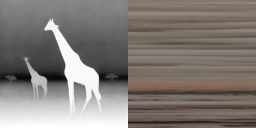

In [61]:
prompt = "a dog with a long neck"
control_img = depths[2]

image = controlnet_pipeline(
  prompt,
  image=control_img,
  num_inference_steps=30,
  generator=torch.manual_seed(20)
).images[0]

utils.make_image_grid([control_img.resize((128, 128)), image.resize((5128, 128))], rows=1, cols=2)

  0%|          | 0/30 [00:00<?, ?it/s]

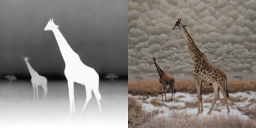

In [62]:
prompt = "Giraffes in a snowy field"
control_img = depths[2]

image = controlnet_pipeline(
  prompt,
  image=control_img,
  num_inference_steps=30,
  generator=torch.manual_seed(20)
).images[0]

utils.make_image_grid([control_img.resize((128, 128)), image.resize((128, 128))], rows=1, cols=2)

  0%|          | 0/30 [00:00<?, ?it/s]

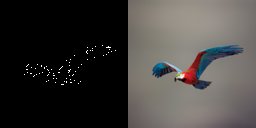

In [63]:
prompt = "a photo of a parrot"
control_img = canny[1]

controlnet_pipeline.controlnet = controlnet_canny
controlnet_pipeline.controlnet.to(device)

image = controlnet_pipeline(
  prompt,
  image=control_img,
  num_inference_steps=30,
  generator=torch.manual_seed(20)
).images[0]

utils.make_image_grid([control_img.resize((128, 128)), image.resize((128, 128))], rows=1, cols=2)

  0%|          | 0/30 [00:00<?, ?it/s]

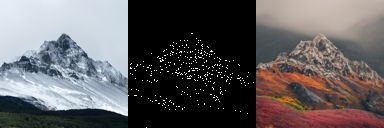

In [64]:
prompt = "a mountain in the fall, leaves changing colors"
control_img = canny[4]

image = controlnet_pipeline(
  prompt,
  image=control_img,
  num_inference_steps=30,
  generator=torch.manual_seed(20),
).images[0]

utils.make_image_grid([images[4].resize((128, 128)), control_img.resize((128, 128)), image.resize((128, 128))], rows=1, cols=3)

  0%|          | 0/30 [00:00<?, ?it/s]

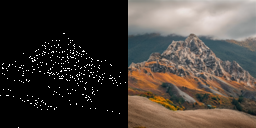

In [65]:
prompt = "a mountain in the fall, leaves changing colors, award-wining, high quality, 8k, shot on a Sony A7III"
negative_prompt = "illustration, 2d, cartoon, sketch, dark, blurry"

image = controlnet_pipeline(
  prompt,
  negative_prompt=negative_prompt,
  image=control_img,
  num_inference_steps=30,
  generator=torch.manual_seed(20)
).images[0]

utils.make_image_grid([control_img.resize((128, 128)), image.resize((128, 128))], rows=1, cols=2)

  0%|          | 0/30 [00:00<?, ?it/s]

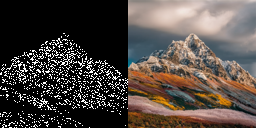

In [66]:
prompt = "a mountain in the fall, leaves changing colors, award-wining, high quality, 8k, shot on a Sony A7III"
negative_prompt = "illustration, 2d, cartoon, sketch, dark, blurry"
control_img = Image.fromarray(feature.canny(np.array(images[4].convert('L')), sigma=1))

image = controlnet_pipeline(
  prompt,
  negative_prompt=negative_prompt,
  image=control_img,
  num_inference_steps=30,
  generator=torch.manual_seed(20)
).images[0]

utils.make_image_grid([control_img.resize((128, 128)), image.resize((128, 128))], rows=1, cols=2)

  0%|          | 0/30 [00:00<?, ?it/s]

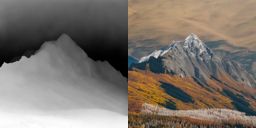

In [67]:
prompt = "a mountain in the fall, leaves changing colors, award-wining, high quality, 8k, shot on a Sony A7III"
negative_prompt = "illustration, 2d, cartoon, sketch, dark, blurry"
control_img = depths[4]

controlnet_pipeline.controlnet = controlnet_depth

image = controlnet_pipeline(
  prompt,
  negative_prompt=negative_prompt,
  image=control_img,
  num_inference_steps=30,
  generator=torch.manual_seed(20)
).images[0]

utils.make_image_grid([control_img.resize((128, 128)), image.resize((128, 128))], rows=1, cols=2)

## 7.18 Understanding and Experimenting with ControlNet Parameters

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

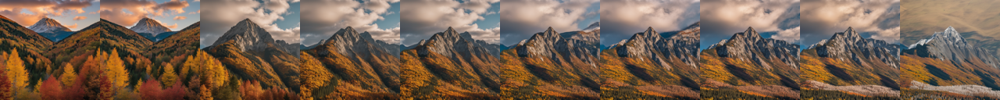

In [68]:
images = []

for s in np.linspace(0, 1, 10):
  images += controlnet_pipeline(
    prompt,
    negative_prompt=negative_prompt,
    image=control_img,
    num_inference_steps=30,
    generator=torch.manual_seed(20),
    controlnet_conditioning_scale=s
  ).images

utils.make_image_grid([img.resize((128, 128)) for img in images], rows=1, cols=10)

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

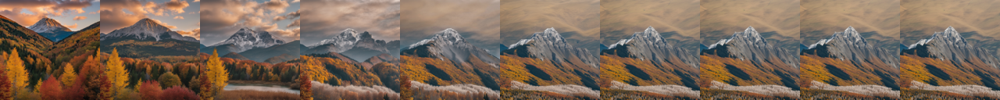

In [69]:
images = []

for g in np.linspace(0.01, 1, 10):
  images += controlnet_pipeline(
    prompt,
    negative_prompt=negative_prompt,
    image=control_img,
    num_inference_steps=30,
    generator=torch.manual_seed(20),
    control_guidance_end=g
  ).images

utils.make_image_grid([img.resize((128, 128)) for img in images], rows=1, cols=10)

  0%|          | 0/30 [00:00<?, ?it/s]

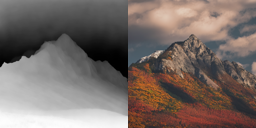

In [70]:
prompt = "a mountain in the fall, leaves changing colors"

image = controlnet_pipeline(
  prompt,
  image=control_img,
  num_inference_steps=30,
  generator=torch.manual_seed(20),
  controlnet_conditioning_scale=0.7,
  control_guidance_end=0.7
).images[0]

utils.make_image_grid([control_img.resize((128, 128)), image.resize((128, 128))], rows=1, cols=2)

In [71]:
controlnet_pipeline.load_lora_weights("jonathandinu/sdxl-metamorphosis-lora", weight_name="pytorch_lora_weights.safetensors")

  0%|          | 0/30 [00:00<?, ?it/s]

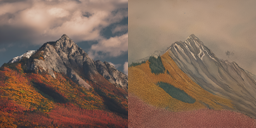

In [72]:
image_lora = controlnet_pipeline(
  prompt,
  image=control_img,
  num_inference_steps=30,
  generator=torch.manual_seed(20),
  controlnet_conditioning_scale=0.7,
  control_guidance_end=0.7
).images[0]

utils.make_image_grid([image.resize((128, 128)), image_lora.resize((128, 128))], rows=1, cols=2)

## 7.19 Generative Text Effects with Font Depth Maps

In [73]:
controlnet_pipeline.unload_lora_weights()

In [74]:
!wget -nc https://raw.githubusercontent.com/jonathandinu/programming-generative-ai/refs/heads/main/images/bubble-text.png

--2024-12-16 02:12:41--  https://raw.githubusercontent.com/jonathandinu/programming-generative-ai/refs/heads/main/images/bubble-text.png
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 57938 (57K) [image/png]
Saving to: ‘bubble-text.png’

bubble-text.png     100%[===================>]  56.58K  --.-KB/s    in 0.001s  

2024-12-16 02:12:42 (41.2 MB/s) - ‘bubble-text.png’ saved [57938/57938]



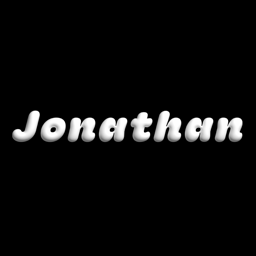

In [75]:
# generative text
gen_text = Image.open("bubble-text.png").resize((1024,1024))
gen_text.resize((256, 256))

  0%|          | 0/30 [00:00<?, ?it/s]

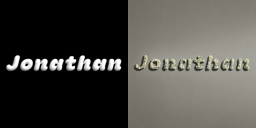

In [76]:
prompt = 'the text "Jonathan" made out of flowers'
controlnet_pipeline.controlnet = controlnet_depth

output_img = controlnet_pipeline(
  prompt,
  image=gen_text,
  num_inference_steps=30,
  generator=torch.manual_seed(17),
).images[0]

utils.make_image_grid([gen_text.resize((128, 128)), output_img.resize((128, 128))], rows=1, cols=2)

In [77]:
controlnet_pipeline.to('cpu')
del controlnet_pipeline

Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, due to the lack of support for`float16` operations on this device in PyTorch. Please, remove the `torch_dtype=torch.float16` argument, or use another device for inference.
Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, due to the lack of support for`float16` operations on this device in PyTorch. Please, remove the `torch_dtype=torch.float16` argument, or use another device for inference.
Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, du

## 7.21 Reasons to distill

Benefits/use cases:
- generally makes all of workflow faster/more efficient.
- faster iterations when doing parameter sweeps. good starting point. find best parameters/prompts approx. and then get more specific w/ search.
- new capabilities (0 to 1), interactive/realtime apps. webcam stuff.
- frame-by-frame video processing reasonably tractable

In [78]:
# these timing/outputs were run on an L4 GPU in Colab
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

Mon Dec 16 02:13:03 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA L4                      Off | 00000000:00:03.0 Off |                    0 |
| N/A   71C    P0              34W /  72W |  22099MiB / 23034MiB |     10%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

## 7.22 Comparing SDXL and SDXL Turbo

In [79]:
from diffusers import AutoPipelineForText2Image, AutoPipelineForImage2Image

vae = AutoencoderKL.from_pretrained("madebyollin/sdxl-vae-fp16-fix", torch_dtype=torch.float16)

pipeline_base = AutoPipelineForText2Image.from_pretrained(
    "stabilityai/stable-diffusion-xl-base-1.0",
    vae=vae,
    torch_dtype=torch.float16,
    variant="fp16"
)
pipeline_base.to(device)

pipeline_turbo = AutoPipelineForText2Image.from_pretrained(
    "stabilityai/sdxl-turbo",
    vae=vae,
    torch_dtype=torch.float16,
    variant="fp16"
)

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

model_index.json:   0%|          | 0.00/685 [00:00<?, ?B/s]

Fetching 16 files:   0%|          | 0/16 [00:00<?, ?it/s]

model.fp16.safetensors:   0%|          | 0.00/246M [00:00<?, ?B/s]

model.fp16.safetensors:   0%|          | 0.00/1.39G [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

text_encoder_2/config.json:   0%|          | 0.00/575 [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/586 [00:00<?, ?B/s]

text_encoder/config.json:   0%|          | 0.00/565 [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/704 [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/459 [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

tokenizer_2/special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/1.78k [00:00<?, ?B/s]

tokenizer_2/tokenizer_config.json:   0%|          | 0.00/855 [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/5.14G [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [80]:
prompt = "An astronaut riding a seahorse"

In [81]:
%%time

img_base = pipeline_base(
    prompt=prompt,
    guidance_scale=7.5,
    num_inference_steps=30,
    generator=torch.manual_seed(20)
).images[0]

  0%|          | 0/30 [00:00<?, ?it/s]

CPU times: user 7.8 s, sys: 4.94 s, total: 12.7 s
Wall time: 12.7 s


In [82]:
pipeline_base.to('cpu');
pipeline_turbo.to(device);

Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, due to the lack of support for`float16` operations on this device in PyTorch. Please, remove the `torch_dtype=torch.float16` argument, or use another device for inference.
Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, due to the lack of support for`float16` operations on this device in PyTorch. Please, remove the `torch_dtype=torch.float16` argument, or use another device for inference.
Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, du

In [83]:
%%time

img_turbo = pipeline_turbo(
    prompt=prompt,
    guidance_scale=0.0,
    num_inference_steps=1,
    generator=torch.manual_seed(20),
    height=512, width=512
).images[0]

  0%|          | 0/1 [00:00<?, ?it/s]

CPU times: user 349 ms, sys: 0 ns, total: 349 ms
Wall time: 321 ms


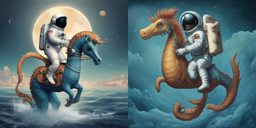

In [84]:
utils.make_image_grid([img_base.resize((128, 128)), img_turbo.resize((128, 128))], rows=1, cols=2)

In [85]:
pipeline_turbo.to('cpu');
pipeline_base.to(device);

Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, due to the lack of support for`float16` operations on this device in PyTorch. Please, remove the `torch_dtype=torch.float16` argument, or use another device for inference.
Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, due to the lack of support for`float16` operations on this device in PyTorch. Please, remove the `torch_dtype=torch.float16` argument, or use another device for inference.
Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, du

In [86]:
%%time

img_base = pipeline_base(
    prompt=prompt,
    guidance_scale=7.5,
    num_inference_steps=4,
    generator=torch.manual_seed(20),
).images[0]

  0%|          | 0/4 [00:00<?, ?it/s]

CPU times: user 1.57 s, sys: 550 ms, total: 2.11 s
Wall time: 2.08 s


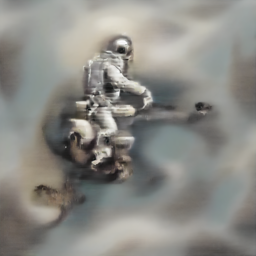

In [87]:
img_base.resize((256, 256))

In [88]:
pipeline_base.to('cpu');
pipeline_turbo.to(device);

Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, due to the lack of support for`float16` operations on this device in PyTorch. Please, remove the `torch_dtype=torch.float16` argument, or use another device for inference.
Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, due to the lack of support for`float16` operations on this device in PyTorch. Please, remove the `torch_dtype=torch.float16` argument, or use another device for inference.
Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, du

## 7.23 Text-Guided Image-to-Image Translation

100%|██████████| 6/6 [00:07<00:00,  1.30s/it]


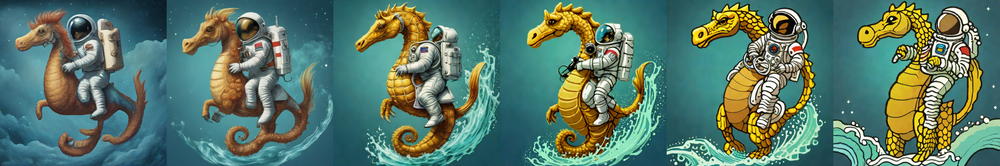

In [89]:
images = []

pipeline_turbo.set_progress_bar_config(disable=True)

for i in tqdm([1, 2, 4, 8, 16, 32]):
  images += pipeline_turbo(
    prompt,
    guidance_scale=0.0,
    num_inference_steps=i,
    generator=torch.manual_seed(20),
    height=512, width=512
).images

# SDXL-Turbo only intended for 1-4 steps
# https://huggingface.co/docs/diffusers/main/en/api/pipelines/stable_diffusion/sdxl_turbo#tips
utils.make_image_grid([img.resize((512, 512)) for img in images], rows=1, cols=6)

In [90]:
pipeline_turbo.to('cpu')

Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, due to the lack of support for`float16` operations on this device in PyTorch. Please, remove the `torch_dtype=torch.float16` argument, or use another device for inference.
Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, due to the lack of support for`float16` operations on this device in PyTorch. Please, remove the `torch_dtype=torch.float16` argument, or use another device for inference.
Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, du

StableDiffusionXLPipeline {
  "_class_name": "StableDiffusionXLPipeline",
  "_diffusers_version": "0.32.0.dev0",
  "_name_or_path": "stabilityai/sdxl-turbo",
  "feature_extractor": [
    null,
    null
  ],
  "force_zeros_for_empty_prompt": true,
  "image_encoder": [
    null,
    null
  ],
  "scheduler": [
    "diffusers",
    "EulerAncestralDiscreteScheduler"
  ],
  "text_encoder": [
    "transformers",
    "CLIPTextModel"
  ],
  "text_encoder_2": [
    "transformers",
    "CLIPTextModelWithProjection"
  ],
  "tokenizer": [
    "transformers",
    "CLIPTokenizer"
  ],
  "tokenizer_2": [
    "transformers",
    "CLIPTokenizer"
  ],
  "unet": [
    "diffusers",
    "UNet2DConditionModel"
  ],
  "vae": [
    "diffusers",
    "AutoencoderKL"
  ]
}

In [91]:
from diffusers import DDIMScheduler

img2img_turbo = AutoPipelineForImage2Image.from_pipe(pipeline_turbo)
img2img_turbo.scheduler = DDIMScheduler.from_config(img2img_turbo.scheduler.config, timestep_spacing="trailing")

img2img_turbo.to("cuda");

In [92]:
import imageio.v3 as iio
from PIL import Image

# Video by Ruvim Miksanskiy on Pexels: https://www.pexels.com/video/video-of-forest-1448735/
raw_url = "https://raw.githubusercontent.com/jonathandinu/programming-generative-ai/refs/heads/main/images/1448735-hd_2048_1080_24fps.mp4"

# bulk read all frames of source driving video
# warning: large videos will consume a lot of memory (RAM)
frames = iio.imread(raw_url, plugin="pyav")

In [93]:
Image.fromarray(frames[0]).size

(2048, 1080)

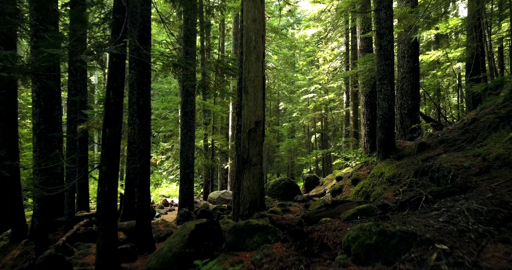

In [94]:
frame = Image.fromarray(frames[0])
w, h = frame.size

# just temporarily resizing to visualize in the notebook
frame.resize((w // 4, h // 4))

In [95]:
from torchvision.transforms import v2

preprocess = v2.Compose(
    [
        v2.ToPILImage(),
        v2.CenterCrop(1080),
        v2.Resize(512)
    ]
)

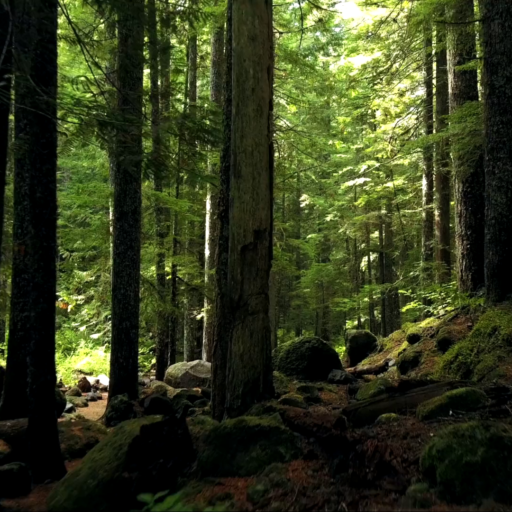

In [96]:
preprocess(frames[0])

  0%|          | 0/2 [00:00<?, ?it/s]

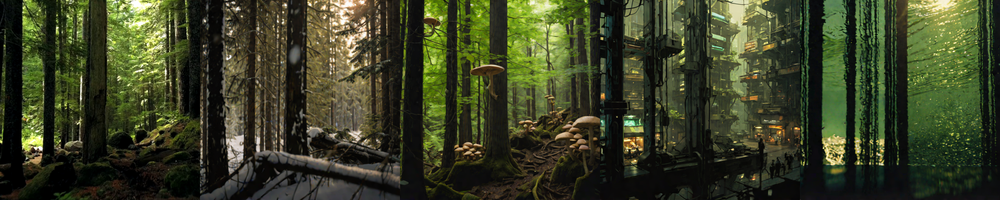

In [97]:
prompts =  [
  "photograph of a snow covered boreal forest, shot on a Sony A7III",
  "a fantastical magic forest filled with giant mushrooms",
  "a sprawling dystopian cyberpunk city",
  "a wide open ocean with a clear sunny sky"
]

src_image = preprocess(frames[0])

images = img2img_turbo(
    prompts,
    image=[src_image] * 4,
    guidance_scale=0.0,
    # num_inference_steps * strength should be >= 1
    strength=0.5,
    # pipeline runs for int(num_inference_steps * strength) steps
    num_inference_steps=4,
    generator=torch.manual_seed(20),
).images

utils.make_image_grid([src_image, *images], rows=1, cols=5)

## 7.24 Video-Driven Frame-by-Frame Generation with SDXL Turbo

In [98]:
frames.shape

(759, 1080, 2048, 3)

In [99]:
prompts =  [
  "photograph of a snow covered boreal forest, shot on a Sony A7III",
  "a fantastical magic forest filled with giant mushrooms",
  "a sprawling dystopian cyberpunk city",
]

running_time = 0

snow_frames = []
mushrooms_frames = []
cyberpunk_frames = []

img2img_turbo.set_progress_bar_config(disable=True)

for frame in tqdm(frames):
    src_image = preprocess(frame)

    start = time.time()
    images = img2img_turbo(
      prompts,
      image=[src_image] * 3,
      guidance_scale=0.0,
      strength=0.5,
      num_inference_steps=4,
      generator=torch.manual_seed(20),
    ).images
    running_time += time.time() - start

    snow_frames.append(images[0])
    mushrooms_frames.append(images[1])
    cyberpunk_frames.append(images[2])

100%|██████████| 759/759 [11:29<00:00,  1.10it/s]


In [100]:
print(f"\nAverage running time {running_time / len(frames) / 3:.3f} second per frame")


Average running time 0.298 second per frame


In [101]:
full_frames = []

for i in range(len(frames)):
  square = [
      preprocess(frames[i]),
      snow_frames[i],
      mushrooms_frames[i],
      cyberpunk_frames[i]
  ]
  full_frames.append(utils.make_image_grid(square, rows=2, cols=2))

In [102]:
utils.export_to_video(full_frames, f"comparison.mp4", 24)

'comparison.mp4'

## 7.25 Near Realtime Inference with PyTorch Performance Optimizations

In [103]:
from diffusers import AutoencoderTiny

# move to CPU for compiling
img2img_turbo.to('cpu')

tiny_vae = AutoencoderTiny.from_pretrained("madebyollin/taesdxl", torch_dtype=torch.float16).to(device)
img2img_turbo.vae = tiny_vae

# compile the UNet and VAE.
img2img_turbo.unet.to(memory_format=torch.channels_last)
img2img_turbo.vae.to(memory_format=torch.channels_last)

img2img_turbo.unet = torch.compile(img2img_turbo.unet, mode="max-autotune", fullgraph=True)
img2img_turbo.vae.decode = torch.compile(img2img_turbo.vae.decode, mode="max-autotune", fullgraph=True)

Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, due to the lack of support for`float16` operations on this device in PyTorch. Please, remove the `torch_dtype=torch.float16` argument, or use another device for inference.
Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, due to the lack of support for`float16` operations on this device in PyTorch. Please, remove the `torch_dtype=torch.float16` argument, or use another device for inference.
Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, du

config.json:   0%|          | 0.00/597 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/9.79M [00:00<?, ?B/s]

In [104]:
# compilation will likely fail on Mac due to Triton not supporting MPS yet (depending on when you run this)
prompts =  [
  "photograph of a snow covered boreal forest, shot on a Sony A7III",
  "a fantastical magic forest filled with giant mushrooms",
  "a sprawling dystopian cyberpunk city",
]

running_time = 0

snow_frames = []
mushrooms_frames = []
cyberpunk_frames = []

img2img_turbo.set_progress_bar_config(disable=True)
# move back to GPU for inference
img2img_turbo.to(device)

for frame in tqdm(frames):
    src_image = preprocess(frame)

    start = time.time()
    images = img2img_turbo(
      prompts,
      image=[src_image] * 3,
      guidance_scale=0.0,
      strength=0.5,
      num_inference_steps=4,
      generator=torch.manual_seed(20),
    ).images
    running_time += time.time() - start

    snow_frames.append(images[0])
    mushrooms_frames.append(images[1])
    cyberpunk_frames.append(images[2])

  0%|          | 0/759 [00:00<?, ?it/s]W1216 02:29:25.368000 1219 torch/_inductor/utils.py:1048] [0/0] Not enough SMs to use max_autotune_gemm mode
AUTOTUNE addmm(3072x640, 3072x320, 320x640)
  bias_addmm 0.0451 ms 100.0% 
  addmm 0.0737 ms 61.1% 
SingleProcess AUTOTUNE benchmarking takes 0.2212 seconds and 0.0001 seconds precompiling
AUTOTUNE addmm(768x1280, 768x640, 640x1280)
  bias_addmm 0.0430 ms 100.0% 
  addmm 0.0502 ms 85.7% 
SingleProcess AUTOTUNE benchmarking takes 0.2169 seconds and 0.0001 seconds precompiling
AUTOTUNE addmm(768x1280, 768x2560, 2560x1280)
  addmm 0.1403 ms 100.0% 
  bias_addmm 0.1413 ms 99.3% 
SingleProcess AUTOTUNE benchmarking takes 0.2198 seconds and 0.0001 seconds precompiling
AUTOTUNE addmm(768x1280, 768x1920, 1920x1280)
  bias_addmm 0.1167 ms 100.0% 
  addmm 0.1208 ms 96.6% 
SingleProcess AUTOTUNE benchmarking takes 0.2173 seconds and 0.0001 seconds precompiling
AUTOTUNE addmm(3072x640, 3072x1920, 1920x640)
  addmm 0.1843 ms 100.0% 
  bias_addmm 0.1904 

In [105]:
# approaches ~0.05 sec/frame on an A100 GPU
print(f"\nAverage running time {running_time / len(frames) / 3:.3f} second per frame")


Average running time 0.188 second per frame


https://github.com/cumulo-autumn/StreamDiffusion

## Appendix

In [106]:
# version of Python of the current Jupyter kernel
import sys, datetime

print(f"Current notebook Python version: {sys.version}")
print(f"Notebook last executed: {datetime.datetime.now()}")

Current notebook Python version: 3.10.12 (main, Nov  6 2024, 20:22:13) [GCC 11.4.0]
Notebook last executed: 2024-12-16 02:35:39.387602


In [107]:
# package versions when this notebook was last run in Colab (and committed)
!pip freeze

absl-py==1.4.0
accelerate==1.1.1
aiohappyeyeballs==2.4.4
aiohttp==3.11.10
aiosignal==1.3.1
alabaster==1.0.0
albucore==0.0.19
albumentations==1.4.20
altair==5.5.0
annotated-types==0.7.0
anyio==3.7.1
argon2-cffi==23.1.0
argon2-cffi-bindings==21.2.0
args==0.1.0
array_record==0.5.1
arviz==0.20.0
astropy==6.1.7
astropy-iers-data==0.2024.12.9.0.36.21
astunparse==1.6.3
async-timeout==4.0.3
atpublic==4.1.0
attrs==24.2.0
audioread==3.0.1
autograd==1.7.0
av==13.0.0
babel==2.16.0
backcall==0.2.0
beautifulsoup4==4.12.3
bigframes==1.27.0
bigquery-magics==0.4.0
bitsandbytes==0.45.0
bleach==6.2.0
blinker==1.9.0
blis==0.7.11
blosc2==2.7.1
bokeh==3.6.2
Bottleneck==1.4.2
bqplot==0.12.43
braceexpand==0.1.7
branca==0.8.0
CacheControl==0.14.1
cachetools==5.5.0
catalogue==2.0.10
certifi==2024.8.30
cffi==1.17.1
chardet==5.2.0
charset-normalizer==3.4.0
chex==0.1.87
clarabel==0.9.0
click==8.1.7
clint==0.5.1
clip @ git+https://github.com/openai/CLIP.git@dcba3cb2e2827b402d2701e7e1c7d9fed8a20ef1
cloudpathlib==0.2